# Import input files

In [226]:
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    COLAB = True
    print("Note: using Google CoLab")
except:
    print("Note: not using Google CoLab")
    COLAB = False

PATH = '/content/drive/MyDrive/ColabResources/AudioProject' # make sure to adjust this based on your own file paths in google drive

Mounted at /content/drive
Note: using Google CoLab


# Setup imports and files

In [227]:
import sys, os
import librosa
import matplotlib.pyplot as plt
from IPython.display import Audio
import scipy.stats
from matplotlib.ticker import MultipleLocator
import IPython.display as ipd
import numpy as np

# the following audio files can be downloaded off of the github containing this notebook
FOLDER_PATH = 'bach-fugue3-wtc1'
AUDIO_PATH = 'OG-slow.wav'
MODEL_PATH_1 = 'OG-fast.wav'
MODEL_PATH_2 = 'SCHIFF.wav'
# FOLDER_PATH = 'chopin-op10-no4'
# AUDIO_PATH = 'OG.wav'
# MODEL_PATH_1 = 'KISSIN.wav'
# MODEL_PATH_2 = 'LIU.wav'
# FOLDER_PATH = 'prokofiev-op75-no1'
# AUDIO_PATH = 'GAVRILOV.wav'
# MODEL_PATH_1 = 'KISSIN.wav'
# MODEL_PATH_2 = 'CHIU.wav'

AUDIO_FILE = os.path.join(PATH, FOLDER_PATH, AUDIO_PATH)
MODEL_FILE_1 = os.path.join(PATH, FOLDER_PATH, MODEL_PATH_1)
MODEL_FILE_2 = os.path.join(PATH, FOLDER_PATH, MODEL_PATH_2)

# where y = audio data and sr = sampling rate
y_0_duration = librosa.get_duration(path=AUDIO_FILE) # og
y_1_duration = librosa.get_duration(path=MODEL_FILE_1)
y_2_duration = librosa.get_duration(path=MODEL_FILE_2)
y, sr = librosa.load(AUDIO_FILE, duration=y_0_duration)

audio_list = []
tup = (y, sr,'OG')
audio_list.append((y,sr,'OG'))
x, fs = librosa.load(MODEL_FILE_1, duration=y_1_duration)
tup = ((x, fs, os.path.basename(MODEL_FILE_1)))
audio_list.append(tup)
x, fs = librosa.load(MODEL_FILE_2, duration=y_2_duration)
tup = ((x, fs, os.path.basename(MODEL_FILE_2)))
audio_list.append(tup)

OG_index = 0
MODEL_index = 2


# Defining Key Methods

In [228]:
def find_nearest(array, value): # find nearest value in an array
  """
    Finds the closest float in an array to the given value parameter.

    Parameters:
        array (array-like): Array of floats.
        value (float): Target value to find in the array.

    Returns:
        idx (integer): Index of the closest number to the value parameter found in the array.
  """
  return (np.abs(array - value)).argmin()

def compute_tempogram(beat_positions, window_size=1.0, fps=100, smooth_sigma=250.0, name=''):
  """
    Computes a tempogram (time-varying tempo representation) from beat positions.

    Parameters:
        beat_positions (array-like): Timestamps of detected beats in seconds.
        window_size (float, optional): Sliding window size in seconds. Default is 1.0.
        fps (int, optional): Frames per second for the tempogram timeline. Default is 100.
        smooth_sigma (float or None, optional): Standard deviation for Gaussian smoothing.
            If None, no smoothing is applied. Default is 250.0.
        name (str, optional): Optional name for labeling the visualization. Default is ''.

    Returns:
        tempogram (numpy.ndarray): Array of tempo values (in BPM) over time.
        beat_times (numpy.ndarray): Corresponding timeline for the tempogram (in seconds).
  """
  # 1. Calculate Inter-Beat Intervals (IBIs)
  intervals = np.diff(beat_positions)
  tempos = 60.0 / intervals  # Convert intervals to BPM (60 / interval)

  # 2. Create a timeline for the tempogram
  total_duration = beat_positions[-1]
  beat_times = np.arange(beat_positions[0], total_duration, 1.0 / fps)
  tempogram = np.zeros(len(beat_times))

  # 3. Calculate the tempogram by sliding window
  for i, t in enumerate(beat_times):
      # Find beats within the current window
      start = t - (window_size / 2)
      end = t + (window_size / 2)
      within_window = (beat_positions[:-1] >= start) & (beat_positions[:-1] < end)
      if np.any(within_window):
          tempogram[i] = np.mean(tempos[within_window])
      else:
          if i != 0:
            tempogram[i] = tempogram[i-1]
          else:
            continue

  # 4. Smooth and normalize
  tempogram = gaussian_filter1d(tempogram, sigma=smooth_sigma)
  if tempogram[-1] == 0:
    tempogram.pop()
    beat_times.pop()
  if tempogram[0] == 0:
    tempogram.pop(0)
    beat_times.pop(0)
  return tempogram, beat_times


def average_tempograms(tempogram1, times1, tempogram2, times2):
  # 1. Create a common time array
  start_time = max(times1[0], times2[0])
  end_time = min(times1[-1], times2[-1])
  min_time_increment = min(np.diff(times1).min(), np.diff(times2).min())
  common_times = np.arange(start_time, end_time, min_time_increment)

  # 2. Interpolate both tempograms onto the common time base
  resampled_tempogram1 = np.interp(common_times, times1, tempogram1)
  resampled_tempogram2 = np.interp(common_times, times2, tempogram2)

  # 3. Calculate the average tempogram
  average_tempogram = (resampled_tempogram1 + resampled_tempogram2) / 2

  return average_tempogram, common_times

# Beat Detection - Control Data

Manually inputted beat locations based on ear

In [229]:
import openpyxl

DATA_FILE = os.path.join(PATH, FOLDER_PATH, 'BEATLOC.xlsx')

# Define variable to load the dataframe
workbook = openpyxl.load_workbook(DATA_FILE)

# Define variable to read sheet
sheet = workbook.active

# Iterate the loop to read the cell values
manual_bpm_loc = []
for row in sheet.iter_rows(min_col=0, max_col=0, values_only=True):
  for cell in row:
      if cell is not None:
        manual_bpm_loc.append(cell)

# manual_bpm_loc = manual_bpm_loc[::2]

Visualization

In [230]:
import soundfile as sf

audio, samp_rate = sf.read(AUDIO_FILE)
# make it mono if stereo
if len(audio.shape) > 1:
  audio = np.mean(audio, axis=1)

# sonify the beats and downbeats
# remove the beats that are also downbeats for a nicer sonification
audio_beat = librosa.clicks(times=manual_bpm_loc, sr=samp_rate, click_freq=1000, length=len(audio))
ipd.display(ipd.Audio(audio + audio_beat, rate=samp_rate))

# Beat Detection - Beat This!

## Setup

In [231]:
# install the beat_this package
!pip install --no-deps rotary-embedding-torch https://github.com/CPJKU/beat_this/archive/main.zip

# load the Python class for beat tracking
from beat_this.inference import File2Beats
from beat_this.inference import File2File

  Using cached https://github.com/CPJKU/beat_this/archive/main.zip
  Preparing metadata (setup.py) ... done


In [232]:
audio_path = os.path.join(PATH, FOLDER_PATH, AUDIO_PATH)
file2beats = File2Beats(checkpoint_path="final0", dbn=False)
beats_bt, bt_downbeats = file2beats(audio_path)

## Clean the beats to prevent doubling errors

In [233]:
def fix_extra_beats(beat_times, ratio_threshold=0.7):

  intervals_bt = np.diff(beat_times)  # beat_times = np.array(B)
  median_interval = np.median(intervals_bt)

  suspect_indices = np.where(intervals_bt < ratio_threshold * median_interval)[0]

  cleaned_beats = list(beat_times)
  for i in reversed(suspect_indices):
      # Remove the second of two closely spaced beats
      del cleaned_beats[i + 1]
  return cleaned_beats

beats_bt = fix_extra_beats(beats_bt)

In [234]:
def fix_missed_beats(beat_times, ratio_threshold=1.8):
    beat_times = list(beat_times)  # Make mutable
    i = 1
    while i < len(beat_times) - 2:
        prev_interval = beat_times[i] - beat_times[i - 1]
        curr_interval = beat_times[i + 1] - beat_times[i]
        next_interval = beat_times[i + 2] - beat_times[i + 1]

        # If current interval is much longer than neighbors, insert a midpoint
        if curr_interval > ratio_threshold * prev_interval and curr_interval > ratio_threshold * next_interval:
            new_beat = (beat_times[i] + beat_times[i + 1]) / 2
            beat_times.insert(i + 1, new_beat)
            # Do not increment i to recheck new structure
        else:
            i += 1

    return np.array(beat_times)

beats_bt = fix_missed_beats(beats_bt)

## Visualization

In [237]:
import soundfile as sf

audio, samp_rate = sf.read(audio_path)
# make it mono if stereo
if len(audio.shape) > 1:
  audio = np.mean(audio, axis=1)

# sonify the beats and downbeats
# remove the beats that are also downbeats for a nicer sonification
beats_bt_filter = [b for b in beats_bt if b not in bt_downbeats]
audio_beat = librosa.clicks(times=beats_bt_filter, sr=samp_rate, click_freq=1000, length=len(audio))
audio_downbeat = librosa.clicks(times=bt_downbeats, sr=samp_rate, click_freq=1500, length=len(audio))

ipd.display(ipd.Audio(audio + audio_beat + audio_downbeat, rate=samp_rate))

 # Beat Detection - Librosa

## Compute beats

In [238]:
y = audio_list[OG_index][0]

onset_env = librosa.onset.onset_strength(y=y, sr=sr)

tempo_global = librosa.feature.tempo(y=y,sr=sr) #########
tempo_max = tempo_global * 1.1 #########
tempo_min = tempo_global * 0.65 #########

pulse = librosa.beat.plp(onset_envelope=onset_env, sr=sr, tempo_min=tempo_min, tempo_max=tempo_max)
# Or compute pulse with an alternate prior, like log-normal

prior = scipy.stats.lognorm(loc=np.log(120), scale=120, s=1)
pulse_lognorm = librosa.beat.plp(onset_envelope=onset_env, sr=sr,
                                 prior=prior)
melspec = librosa.feature.melspectrogram(y=y, sr=sr)

In [239]:
tempo, beats = librosa.beat.beat_track(onset_envelope=onset_env, start_bpm=tempo_global)
beats = beats[::2] ##############

beats_plp = np.flatnonzero(librosa.util.localmax(pulse))
beats_plp = beats_plp[::2] ###############

times_dyn = librosa.times_like(onset_env, sr=sr)
times_plp = librosa.times_like(pulse, sr=sr)


## Method analysis

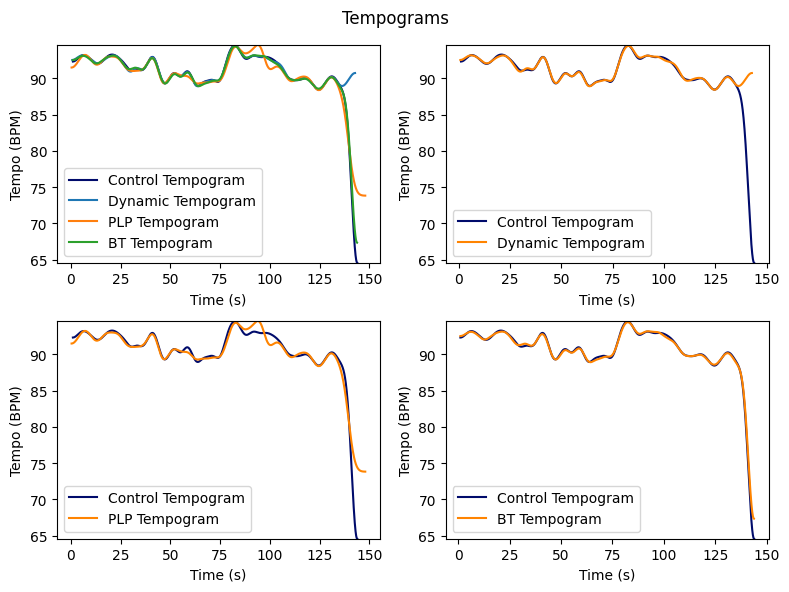

In [240]:
from scipy.ndimage import gaussian_filter1d
import IPython.display as ipd

# Calculate the tempograms
control_tempogram, control_times = compute_tempogram(manual_bpm_loc, name='Control')
dyn_tempogram, dyn_times = compute_tempogram(times_dyn[beats], name='Dynamic Tracker')
plp_tempogram, plp_times = compute_tempogram(times_plp[beats_plp], name='PLP')
bt_tempogram, bt_times = compute_tempogram(beats_bt, name='BT')

 # Plot the tempogram
fig, axs = plt.subplots(2,2, figsize=(8,6))

axs[0,0].plot(control_times, control_tempogram, label="Control Tempogram", color='#000b6b')
axs[0,0].plot(dyn_times, dyn_tempogram, label="Dynamic Tempogram")
axs[0,0].plot(plp_times, plp_tempogram, label="PLP Tempogram")
axs[0,0].plot(bt_times, bt_tempogram, label="BT Tempogram")

axs[0,1].plot(control_times, control_tempogram, label="Control Tempogram", color='#000b6b')
axs[0,1].plot(dyn_times, dyn_tempogram, label="Dynamic Tempogram", color='#ff8400')

axs[1,0].plot(control_times, control_tempogram, label="Control Tempogram", color='#000b6b')
axs[1,0].plot(plp_times, plp_tempogram, label="PLP Tempogram", color='#ff8400')

axs[1,1].plot(control_times, control_tempogram, label="Control Tempogram", color='#000b6b')
axs[1,1].plot(bt_times, bt_tempogram, label="BT Tempogram", color='#ff8400')


# tempo_min = min(min(control_tempogram), min(dyn_tempogram), min(plp_tempogram), min(bt_tempogram))
# tempo_max = max(max(control_tempogram), max(dyn_tempogram), max(plp_tempogram), max(bt_tempogram))

for ax in axs.flat:
  ax.set(xlabel='Time (s)', ylabel='Tempo (BPM)')
  ax.set_ylim(min(min(control_tempogram), min(dyn_tempogram), min(plp_tempogram), min(bt_tempogram)), max(max(control_tempogram), max(dyn_tempogram), max(plp_tempogram), max(bt_tempogram)))
  ax.legend()

fig.suptitle('Tempograms')
fig.tight_layout()

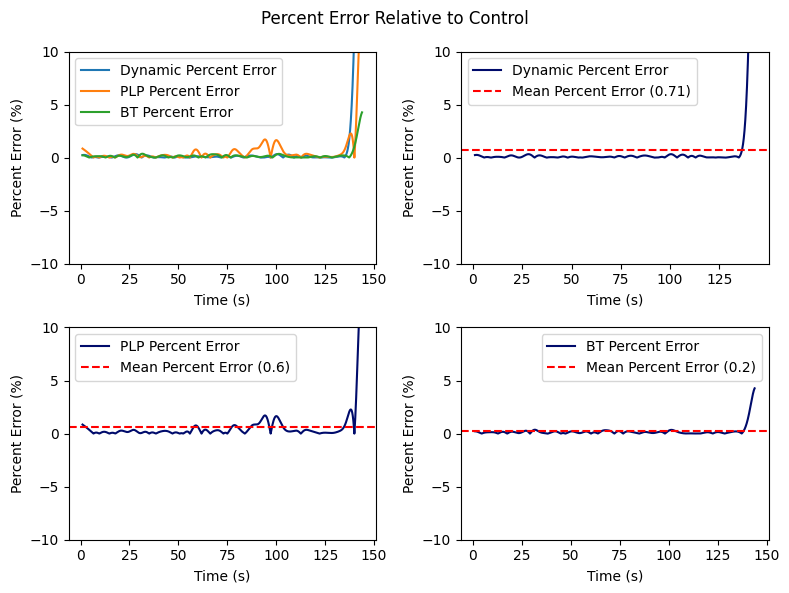

In [241]:
def percent_change(tempogram1, times1, tempogram2, times2):
    start_time = max(times1[0], times2[0])
    end_time = min(times1[-1], times2[-1])
    min_time_increment = min(np.diff(times1).min(), np.diff(times2).min())
    common_times = np.arange(start_time, end_time, min_time_increment)

      # 2. Interpolate both tempograms onto the common time base
    resampled_tempogram1 = np.interp(common_times, times1, tempogram1)
    resampled_tempogram2 = np.interp(common_times, times2, tempogram2)

    out = []
    for idx, x in enumerate(resampled_tempogram1):
      out.append(np.abs(np.subtract(resampled_tempogram2[idx], resampled_tempogram1[idx])) / resampled_tempogram1[idx] * 100)
    return out, common_times

fig, axs = plt.subplots(2,2, figsize=(8,6))

dyn_error, dyn_error_times = percent_change(control_tempogram, control_times, dyn_tempogram, dyn_times)
plp_error, plp_error_times = percent_change(control_tempogram, control_times, plp_tempogram, plp_times)
bt_error, bt_error_times = percent_change(control_tempogram, control_times, bt_tempogram, bt_times)

axs[0,0].plot(dyn_error_times, dyn_error, label="Dynamic Percent Error")
axs[0,0].plot(plp_error_times, plp_error, label="PLP Percent Error")
axs[0,0].plot(bt_error_times, bt_error, label="BT Percent Error")

axs[0,1].plot(dyn_error_times, dyn_error, label="Dynamic Percent Error", color="#000b6b")
axs[0,1].axhline(y=np.mean(dyn_error), color='r', linestyle='--', label=f'Mean Percent Error ({round(np.mean(dyn_error),2)})')

axs[1,0].plot(plp_error_times, plp_error, label="PLP Percent Error", color="#000b6b")
axs[1,0].axhline(y=np.mean(plp_error), color='r', linestyle='--', label=f'Mean Percent Error ({round(np.mean(plp_error),2)})')

axs[1,1].plot(bt_error_times, bt_error, label="BT Percent Error", color="#000b6b")
axs[1,1].axhline(y=np.mean(bt_error), color='r', linestyle='--', label=f'Mean Percent Error ({round(np.mean(bt_error),2)})')

for ax in axs.flat:
  ax.set(xlabel='Time (s)', ylabel='Percent Error (%)')
  ax.set_ylim(-10,10)
  ax.legend()

fig.suptitle('Percent Error Relative to Control')
fig.tight_layout()

Cosine Similarity

In [242]:
def compute_cos(tempogram1, times1, tempogram2, times2):
  start_time = max(times1[0], times2[0])
  end_time = min(times1[-1], times2[-1])
  min_time_increment = min(np.diff(times1).min(), np.diff(times2).min())
  common_times = np.arange(start_time, end_time, min_time_increment)

  # 2. Interpolate both tempograms onto the common time base
  A = np.interp(common_times, times1, tempogram1)
  B = np.interp(common_times, times2, tempogram2)

  from numpy.linalg import norm
  cosine = np.dot(A,B)/(norm(A)*norm(B))
  return cosine

print(compute_cos(control_tempogram, control_times, dyn_tempogram, dyn_times))
print(compute_cos(control_tempogram, control_times, plp_tempogram, plp_times))
print(compute_cos(control_tempogram, control_times, bt_tempogram, bt_times))


0.9995713072004375
0.9999073793902704
0.999992240394488


# DTW + Beat Detection

## Tempogram comparison

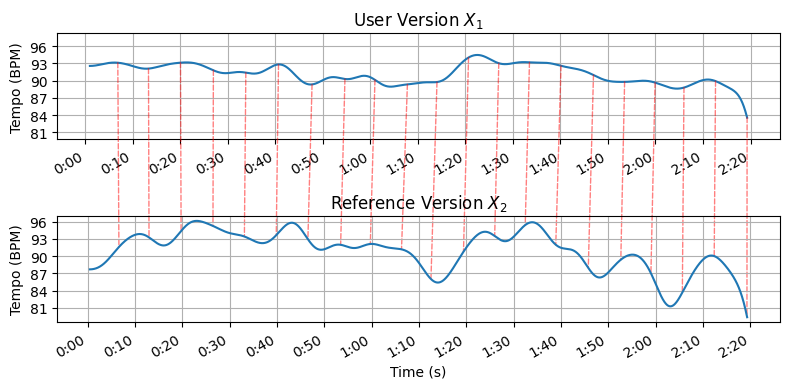

In [243]:
from scipy import stats
import matplotlib.pyplot as plt
from beat_this.inference import Audio2Beats

def remove_outliers(tempogram, times, threshold_z=2):
  z = np.abs(stats.zscore(tempogram))
  outlier_indices = np.where(z > threshold_z)[0]
  no_outliers_tempogram = np.delete(tempogram, outlier_indices)
  no_outliers_times = np.delete(times, outlier_indices)
  return no_outliers_tempogram, no_outliers_times

audio_list_lim = []
audio_list_lim.append(audio_list[OG_index])
audio_list_lim.append(audio_list[MODEL_index])

fig, (ax1, ax2) = plt.subplots(nrows=2, sharex=False, sharey=False, figsize=(8,4))

OG_tempogram = None
OG_times = None
OG_tempo = 120 # librosa default value
OG_y_trunc = None
MODEL_tempogram= None
MODEL_times = None
MODEL_tempo = None
MODEL_y_trunc = None
audio2beats = Audio2Beats(checkpoint_path="final0", dbn=False)

for i, x in enumerate(audio_list_lim):
  data = x[0]
  rate = x[1]
  name = x[2]

  beats_dtw, downbeats_dtw = audio2beats(data, rate)
  beats_dtw = fix_extra_beats(beats_dtw)
  beats_dtw = fix_missed_beats(beats_dtw)
  # Calculate the tempograms
  dtw_tempogram, dtw_times = compute_tempogram(beats_dtw, name='Dynamic Tracker')
  dtw_tempogram, dtw_times = remove_outliers(dtw_tempogram, dtw_times)

  # Plot the tempogram
  if i == 0: # first iteration always looking at user's audio
    ax1.plot(dtw_times, dtw_tempogram, label="BT Tempogram")
    ax1.set(title=f'User Version $X_{i+1}$', ylabel = 'Tempo (BPM)')
    ax1.yaxis.set_major_locator(MultipleLocator(3))
    ax1.xaxis.set_major_locator(MultipleLocator(10))
    ax1.xaxis.set_major_formatter(librosa.display.TimeFormatter(unit='m'))
    ax1.grid(visible=True)
    plt.setp(ax1.get_xticklabels(), rotation=30, ha='right')

    OG_tempogram = dtw_tempogram
    OG_times = dtw_times

    OG_y_trunc, rate = librosa.load(os.path.join(PATH, FOLDER_PATH, AUDIO_PATH), duration=np.max(dtw_times))

  elif i == 1: # second iteration looking at model audio
    ax2.plot(dtw_times, dtw_tempogram, label="BT Tempogram")
    ax2.set(title=f'Reference Version $X_{i+1}$', ylabel = 'Tempo (BPM)')
    ax2.yaxis.set_major_locator(MultipleLocator(3))
    ax2.xaxis.set_major_locator(MultipleLocator(10))
    ax2.xaxis.set_major_formatter(librosa.display.TimeFormatter(unit='m'))
    ax2.grid(visible=True)
    plt.setp(ax2.get_xticklabels(), rotation=30, ha='right')

    MODEL_tempogram = dtw_tempogram
    MODEL_times = dtw_times

    MODEL_y_trunc, rate = librosa.load(os.path.join(PATH, FOLDER_PATH, MODEL_PATH_2),duration=np.max(dtw_times))

ax2.set(xlabel='Time (s)')

#### Adjust y-axes to have the same scaling but different limits ####
#determine axes and their limits
ax_selec = [(ax, ax.get_ylim()) for ax in (ax1, ax2)]

#find maximum y-limit spread
max_delta = max([lmax-lmin for _, (lmin, lmax) in ax_selec])

#expand limits of all subplots according to maximum spread
for ax, (lmin, lmax) in ax_selec:
    ax.set_ylim(lmin-(max_delta-(lmax-lmin))/2, lmax+(max_delta-(lmax-lmin))/2)


# Plot the chromagrams for both files
hop_length = 1024

x_1_chroma = librosa.feature.chroma_cqt(y=OG_y_trunc, sr=fs, hop_length=hop_length)
x_2_chroma = librosa.feature.chroma_cqt(y=MODEL_y_trunc, sr=fs, hop_length=hop_length)

# Align chroma sequences
D, wp = librosa.sequence.dtw(X=x_1_chroma, Y=x_2_chroma, metric='cosine')
wp_s = librosa.frames_to_time(wp, sr=fs, hop_length=hop_length)

# Create a connection patch between the aligned time points in each subplot
from matplotlib.patches import ConnectionPatch

n_arrows = 21
for tp1, tp2 in wp_s[::len(wp_s)//n_arrows]:
    index1 = find_nearest(OG_times, tp1)
    index2 = find_nearest(MODEL_times, tp2)
    if index1 == 0 or index2 == 0: # skip this iteration if either index is 0 to avoid out-of-graph connections
      continue

    con = ConnectionPatch(xyA=(tp1, OG_tempogram[index1]), xyB=(tp2, MODEL_tempogram[index2]),
                          axesA=ax1, axesB=ax2,
                          coordsA='data', coordsB='data',
                          color='r', linestyle='--',
                          alpha=0.5)
    con.set_in_layout(False)  # This is needed to preserve layout
    ax2.add_artist(con)

plt.tight_layout()
plt.show()

## Delta comparison

Delta Comparison: $X_1$ - $X_2$

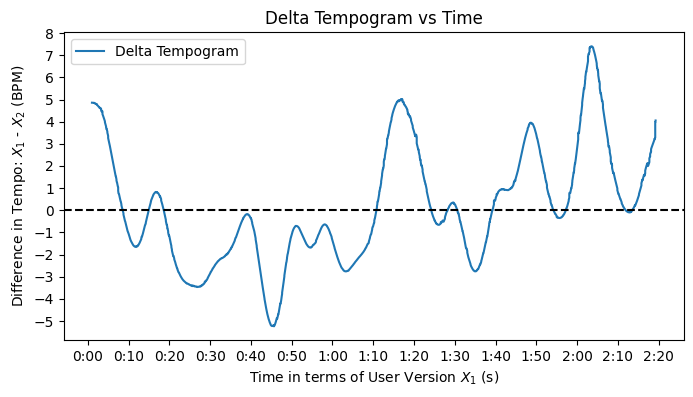

In [244]:
delta_tempogram = np.zeros(len(wp_s))
delta_times = []

# Iterate through the warping path
for i, (idx1, idx2) in enumerate(wp_s):
    # Get the nearest indices
    index1 = find_nearest(OG_times, idx1)
    index2 = find_nearest(MODEL_times, idx2)

    # Calculate the difference for delta_tempogram
    delta_tempogram[i] = OG_tempogram[index1] - MODEL_tempogram[index2]
    delta_times.append(OG_times[index1])

fig, ax = plt.subplots(figsize=(8, 4))
ax.yaxis.set_major_locator(MultipleLocator(1))
ax.xaxis.set_major_locator(MultipleLocator(10))
ax.xaxis.set_major_formatter(librosa.display.TimeFormatter(unit='m'))

ax.plot(delta_times, delta_tempogram, label="Delta Tempogram")
ax.axhline(y=0, color='black', linestyle='dashed')
ax.set(xlabel='Time in terms of User Version $X_1$ (s)')
ax.set(ylabel='Difference in Tempo: $X_1$ - $X_2$ (BPM)')
ax.xaxis.set_major_formatter(librosa.display.TimeFormatter(unit='m'))
plt.title('Delta Tempogram vs Time')
plt.legend()
plt.show()

## Slope comparison

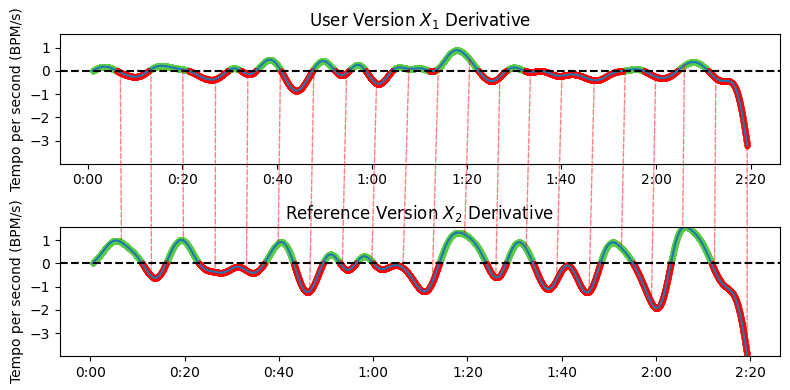

In [247]:
OG_tempogram_deriv = np.gradient(OG_tempogram, OG_times)
MODEL_tempogram_deriv = np.gradient(MODEL_tempogram, MODEL_times)

min_bound = min(np.min(OG_tempogram_deriv), np.min(MODEL_tempogram_deriv))
max_bound = max(np.max(OG_tempogram_deriv), np.max(MODEL_tempogram_deriv))

fig, (ax1, ax2) = plt.subplots(nrows=2, sharex=False, sharey=False, figsize=(8,4))

ax1.plot(OG_times, OG_tempogram_deriv, label='Tempogram Derivative')
ax1.set(title=f'User Version $X_{1}$ Derivative', ylabel = 'Tempo per second (BPM/s)')
ax1.set(ylim=(min_bound, max_bound))
ax1.axhline(y=0, color='black', linestyle='dashed')
pos = np.where(OG_tempogram_deriv > 0)
ax1.scatter(OG_times[pos], OG_tempogram_deriv[pos], color='#58cc43', label='Positive', marker='.')
neg = np.where(OG_tempogram_deriv < 0)
ax1.scatter(OG_times[neg], OG_tempogram_deriv[neg], color='red', label='Negative', marker='.')
ax1.xaxis.set_major_formatter(librosa.display.TimeFormatter(unit='m'))
ax1.yaxis.set_major_locator(MultipleLocator(1))


ax2.plot(MODEL_times, MODEL_tempogram_deriv, label='Tempogram Derivative')
ax2.set(title=f'Reference Version $X_{2}$ Derivative', ylabel = 'Tempo per second (BPM/s)')
ax2.set(ylim=(min_bound, max_bound))
ax2.axhline(y=0, color='black', linestyle='dashed')
pos = np.where(MODEL_tempogram_deriv > 0)
ax2.scatter(MODEL_times[pos], MODEL_tempogram_deriv[pos], color='#58cc43', label='Positive', marker='.')
neg = np.where(MODEL_tempogram_deriv < 0)
ax2.scatter(MODEL_times[neg], MODEL_tempogram_deriv[neg], color='red', label='Negative', marker='.')
ax2.xaxis.set_major_formatter(librosa.display.TimeFormatter(unit='m'))
ax2.yaxis.set_major_locator(MultipleLocator(1))

n_arrows = 21
for tp1, tp2 in wp_s[::len(wp_s)//n_arrows]: # Create a connection patch between the aligned time points in each subplot
    index1 = find_nearest(OG_times, tp1)
    index2 = find_nearest(MODEL_times, tp2)
    if index1 == 0 or index2 == 0: # skip this iteration if either index is 0 to avoid out-of-graph connections
      continue

    con = ConnectionPatch(xyA=(tp1, OG_tempogram_deriv[index1]), xyB=(tp2, MODEL_tempogram_deriv[index2]),
                          axesA=ax1, axesB=ax2,
                          coordsA='data', coordsB='data',
                          color='r', linestyle='--',
                          alpha=0.5)
    con.set_in_layout(False)  # This is needed to preserve layout
    ax2.add_artist(con)

plt.tight_layout()
